In [1]:
import torch
import torch.nn as nn
import torchvision
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torchvision.utils import make_grid
from torchvision.datasets import CIFAR10

import matplotlib.pyplot as plt
import numpy as np
from tqdm.auto import tqdm

## **Plotting**

In [43]:
def show(images, n_images, nrows, title, n):
  fig_size=[n, n]
  plt.figure(figsize=fig_size)
  grid = make_grid(((images + 1) / 2).detach().cpu()[:n_images], nrow=nrows).permute(1,2,0).squeeze()
  plt.title(title)
  plt.imshow(grid)
  plt.show()

## **Downloading and Visualizing Dataset**

In [3]:
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)),
])

In [4]:
dataset = torchvision.datasets.Flowers102('Flowers102', split='test',
                  transform=transform, download=True)
data_loader = DataLoader(dataset, batch_size=128,
                         shuffle=True)

  0%|          | 0/344862509 [00:00<?, ?it/s]

Extracting Flowers102/flowers-102/102flowers.tgz to Flowers102/flowers-102


  0%|          | 0/502 [00:00<?, ?it/s]

  0%|          | 0/14989 [00:00<?, ?it/s]

In [5]:
for i, image in enumerate(data_loader):
  img = image[0]

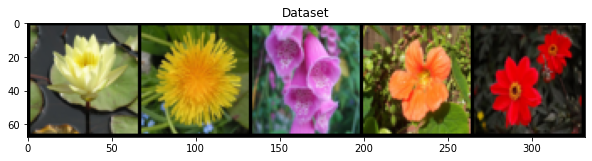

In [6]:
show(img, 25, 5, title='Dataset')

## **Generator**

In [7]:
def generator_block(input, output, kernel_size=4, stride=2, padding=1, last_layer=False, bias=False):
  if not last_layer:
    x = nn.Sequential(
        nn.ConvTranspose2d(input, output, kernel_size, stride, padding, bias=bias),
        nn.BatchNorm2d(output),
        nn.ReLU(inplace=True)
    )
  else:
    x = nn.Sequential(
        nn.ConvTranspose2d(input, output, kernel_size, stride, padding, bias=bias),
        nn.Tanh()
    )
  return x

In [8]:
class Generator(nn.Module):
  def __init__(self, noise_dim, image_dim, hidden_dim):
    super(Generator, self).__init__()
    self.noise_dim = noise_dim
    self.generator = nn.Sequential(
        generator_block(noise_dim, hidden_dim * 8, kernel_size=4, stride=1, padding=0),
        generator_block(hidden_dim * 8, hidden_dim * 4),
        generator_block(hidden_dim * 4, hidden_dim * 2),
        generator_block(hidden_dim * 2, hidden_dim),
        generator_block(hidden_dim, image_dim, last_layer=True)
    )

  def forward(self, noise):
    noise = noise.view(len(noise), self.noise_dim, 1, 1)
    return self.generator(noise)

In [9]:
def get_noise_vectors(n_samples, noise_dim, device='cpu'):
  return torch.randn(n_samples, noise_dim, device=device)

## **Discriminator**

In [10]:
def discriminator_block(input, output, kernel_size=4, stride=2, padding=1, last_layer=False, bias=False):
  if not last_layer:
    x = nn.Sequential(
        nn.utils.spectral_norm(nn.Conv2d(input, output, kernel_size, stride, padding, bias=bias)),
        nn.BatchNorm2d(output),
        nn.LeakyReLU(0.2, inplace=True)
    )
  else:
    x = nn.Sequential(
        nn.utils.spectral_norm(nn.Conv2d(input, output, kernel_size, stride, padding, bias=bias)),
        nn.Sigmoid()
    )
  return x

In [11]:
class Discriminator(nn.Module):
  def __init__(self, image_dim, hidden_dim):
    super(Discriminator, self).__init__()
    self.discr = nn.Sequential(
        discriminator_block(image_dim, hidden_dim),
        discriminator_block(hidden_dim, hidden_dim * 2),
        discriminator_block(hidden_dim * 2, hidden_dim * 4),
        discriminator_block(hidden_dim * 4, hidden_dim * 8,),
        discriminator_block(hidden_dim * 8, 1, stride=1, padding=0, last_layer=True)
    )
  def forward(self, image):
    x = self.discr(image)
    return x.view(len(x), -1)

In [12]:
criterion = nn.BCELoss()
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
noise_dim = 64

# image configs
image_channels = 3
hidden_dim_gen = 64
hidden_dim_discr = 64

epochs = 200
batch_size=128
step = 500
device = 'cuda'

In [13]:
def init_weights(layer):
  if isinstance(layer, nn.Conv2d) or isinstance(layer, nn.ConvTranspose2d):
    nn.init.normal_(layer.weight, 0.0, 0.02)
  if isinstance(layer, nn.BatchNorm2d):
    nn.init.normal_(layer.weight, 1.0, 0.02)
    nn.init.constant_(layer.bias, 0)

generator = Generator(noise_dim, image_channels, hidden_dim_gen).to(device)
gen_optim = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta_1, beta_2))
discriminator = Discriminator(image_channels, hidden_dim_discr).to(device)
disc_optim = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta_1, beta_2))

generator = generator.apply(init_weights)
discriminator = discriminator.apply(init_weights)

## **Training**

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 10
Generator Loss: 5.189888252884151
Discr Loss: 0.3068073294106873


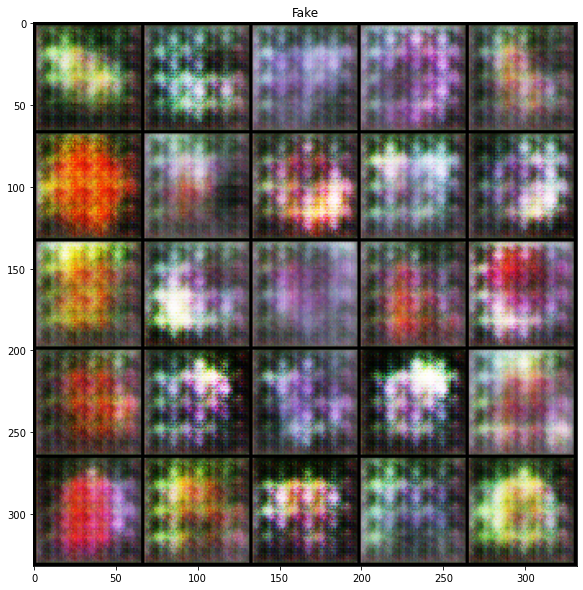

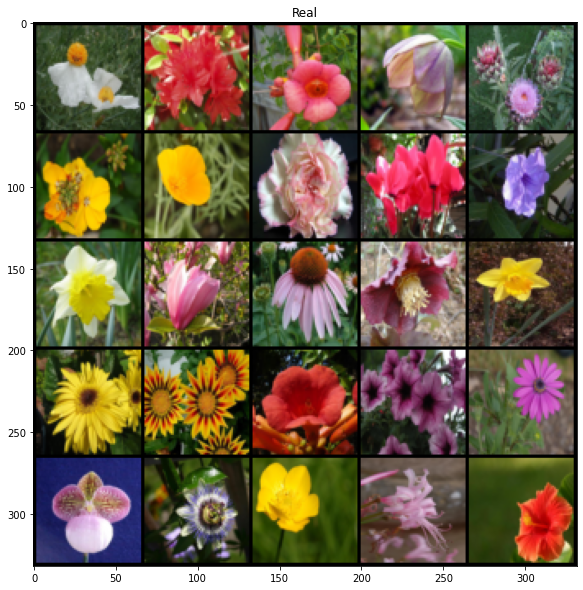

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 20
Generator Loss: 3.902633937060834
Discr Loss: 0.3070031992346048


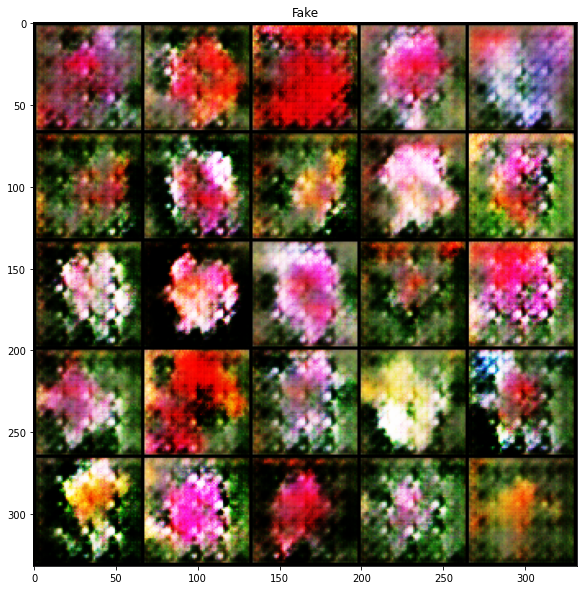

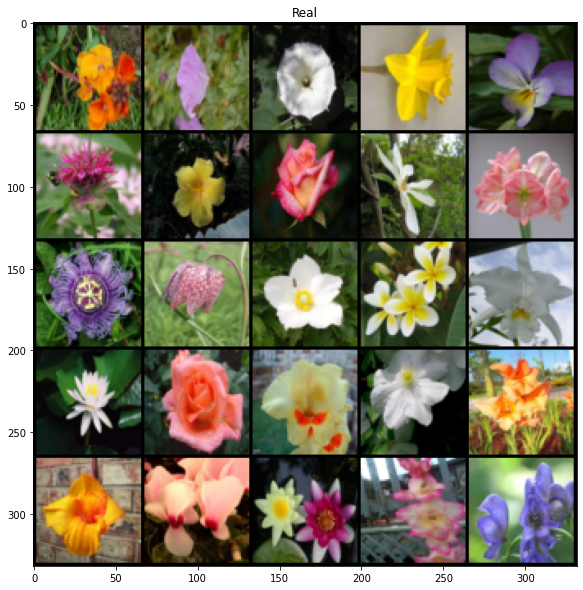

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 30
Generator Loss: 3.5966215951442715
Discr Loss: 0.3356586274504664


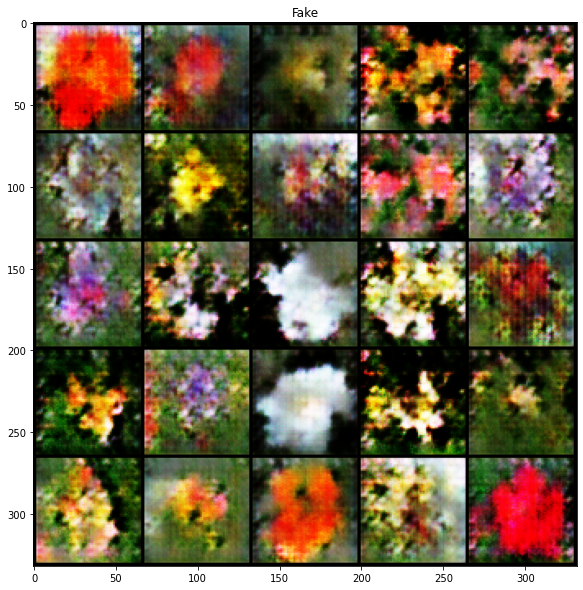

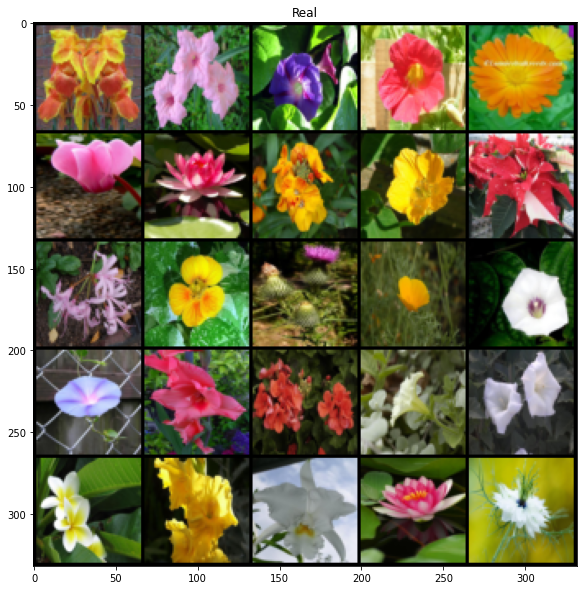

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 40
Generator Loss: 3.335670887827873
Discr Loss: 0.3244410843849182


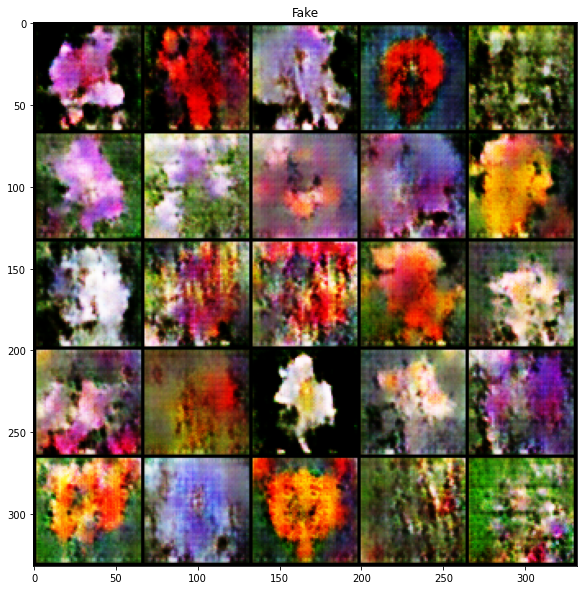

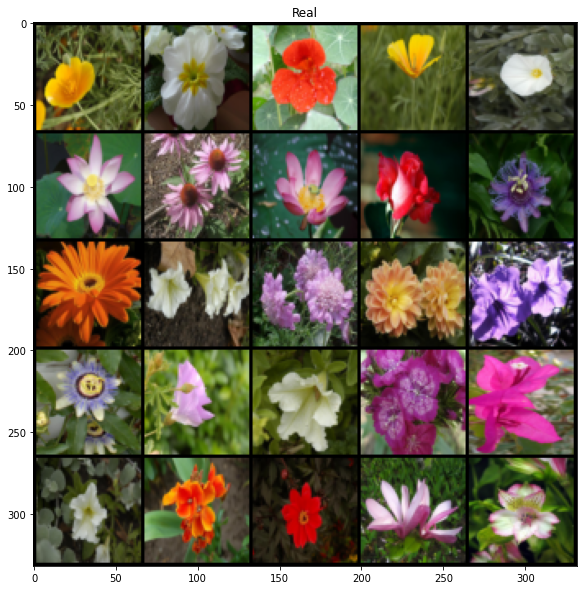

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 51
Generator Loss: 3.225926348529755
Discr Loss: 0.3021698682978748


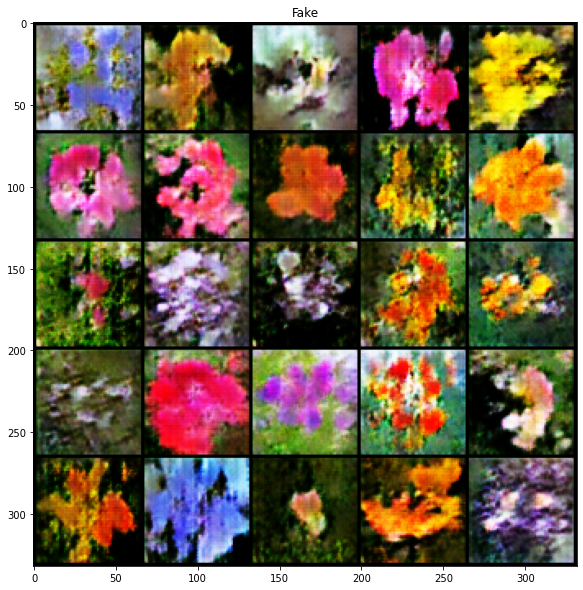

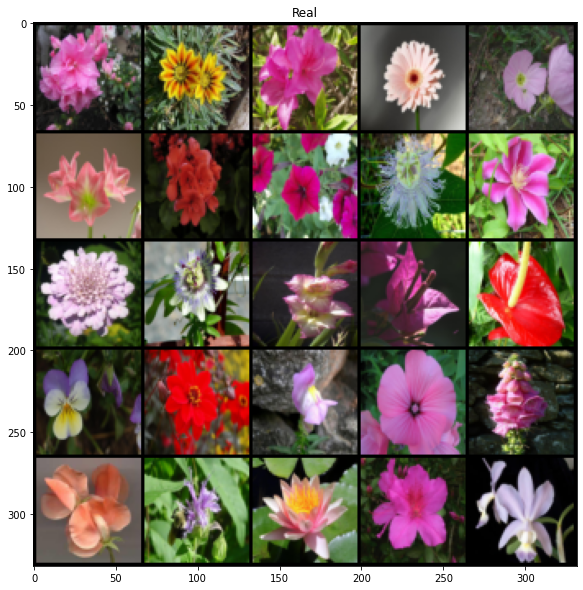

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 61
Generator Loss: 3.002581129312514
Discr Loss: 0.29674056513607494


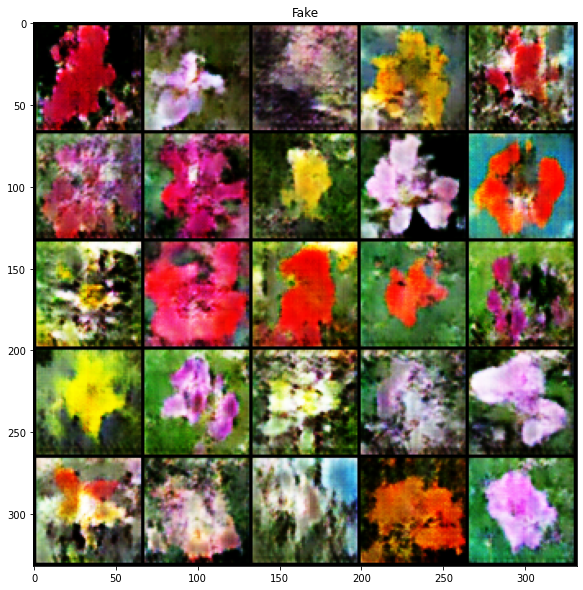

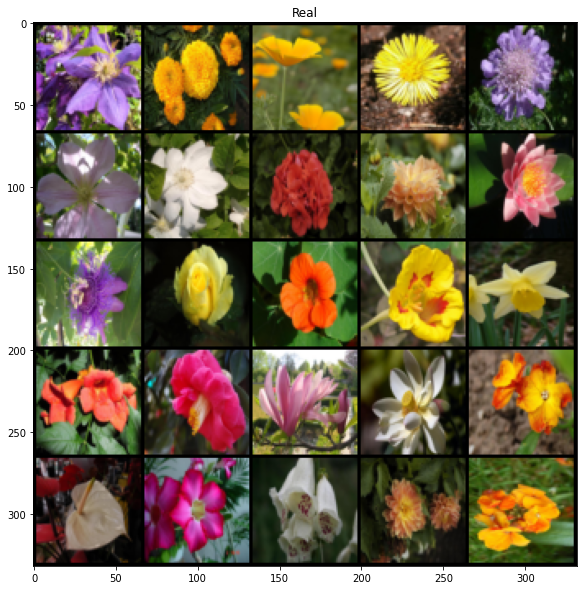

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 71
Generator Loss: 2.821051503643396
Discr Loss: 0.33182605352997785


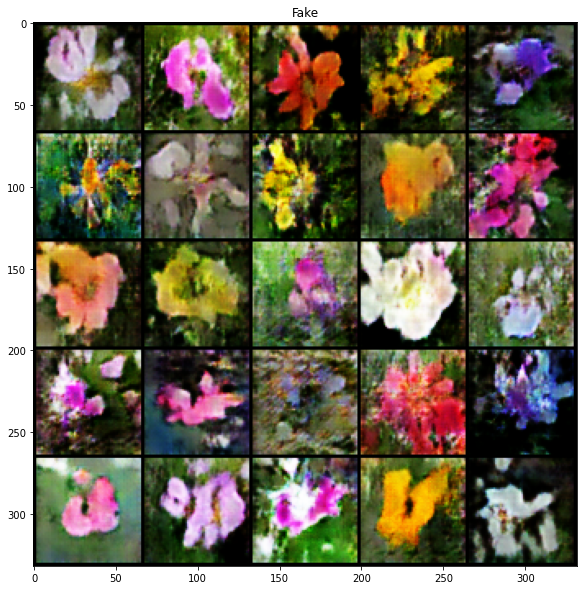

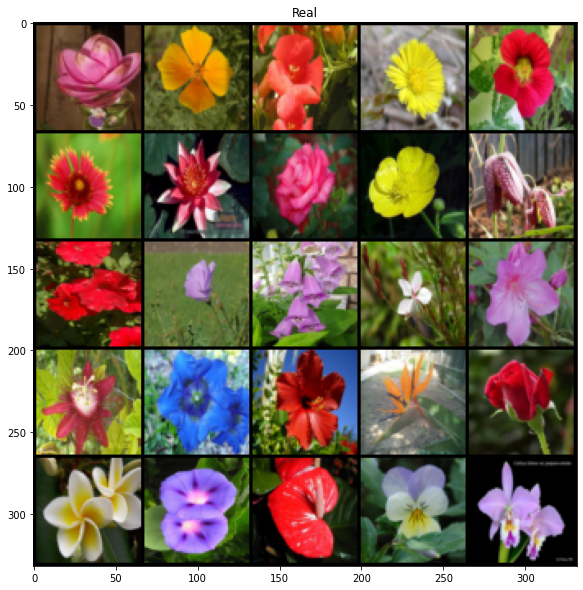

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 81
Generator Loss: 2.7181088124513635
Discr Loss: 0.2985359527468681


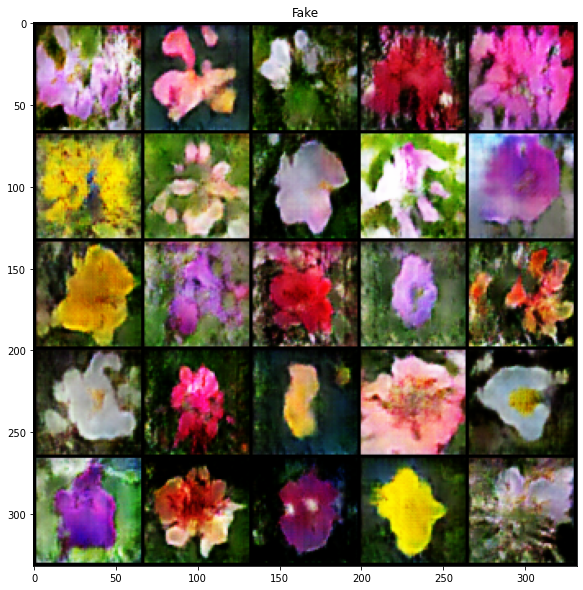

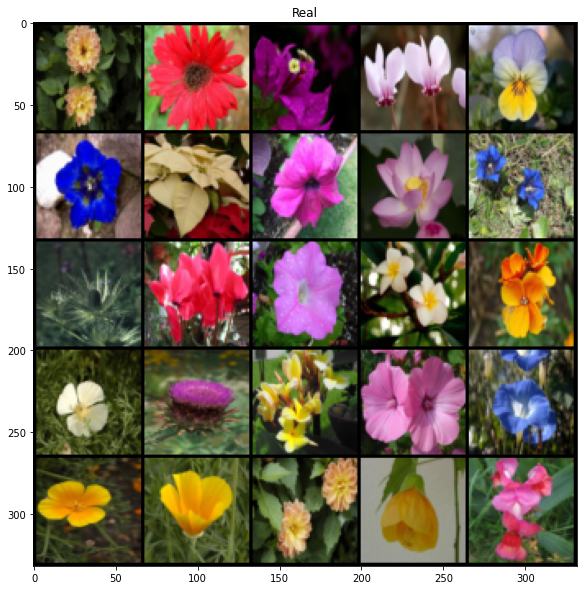

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 91
Generator Loss: 2.7784909752756377
Discr Loss: 0.2915094408392907


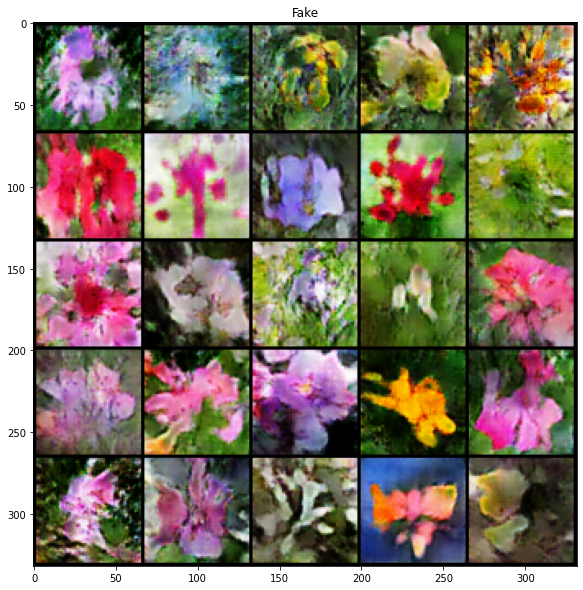

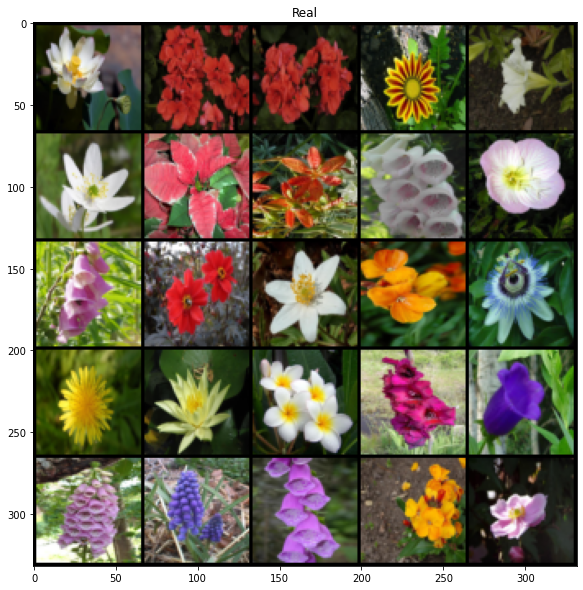

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 102
Generator Loss: 2.8311191633939763
Discr Loss: 0.2664432183802128


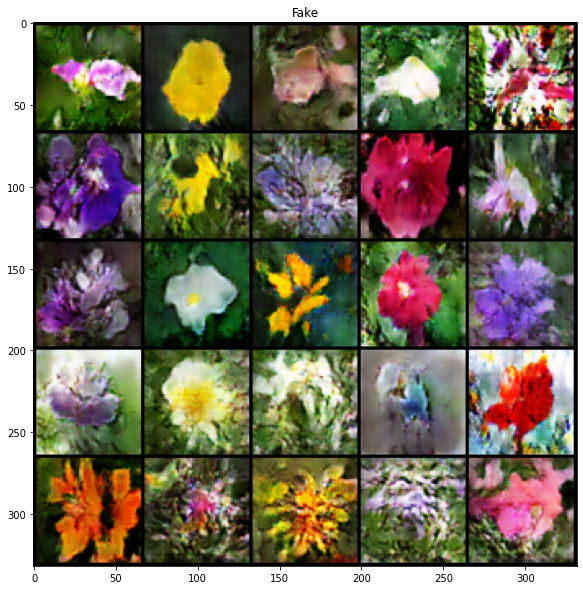

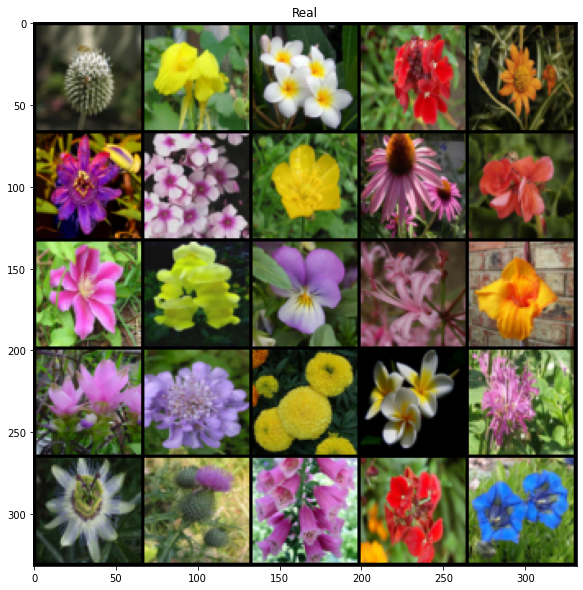

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 112
Generator Loss: 2.8279531839489915
Discr Loss: 0.27144550088047975


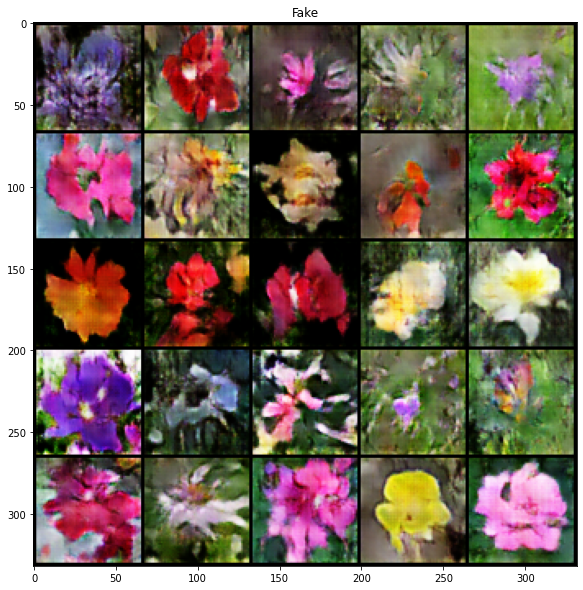

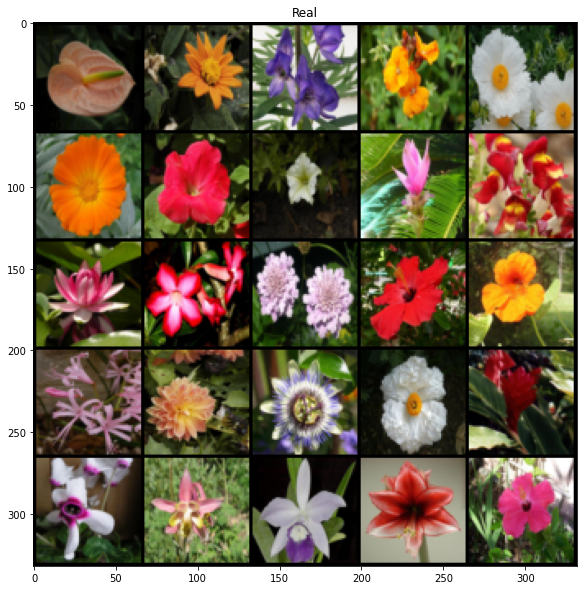

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 122
Generator Loss: 2.9788583399355453
Discr Loss: 0.23300300037860872


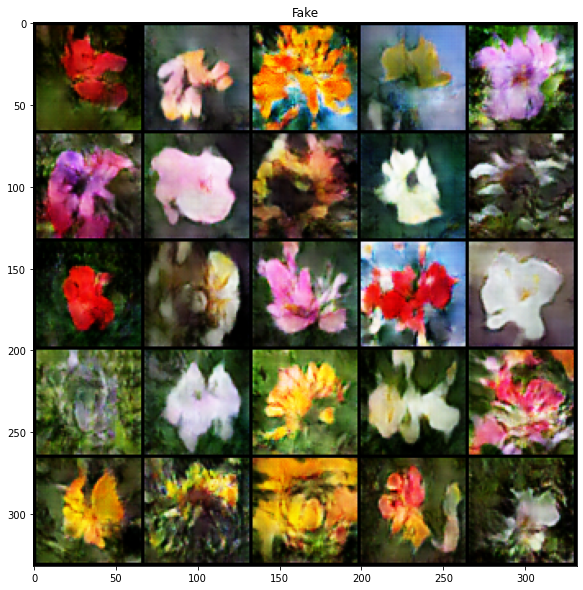

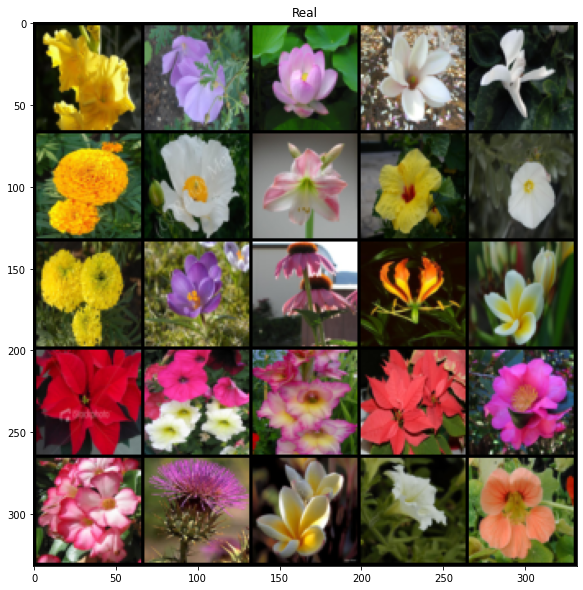

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 132
Generator Loss: 3.1013358026444933
Discr Loss: 0.1951803441643714


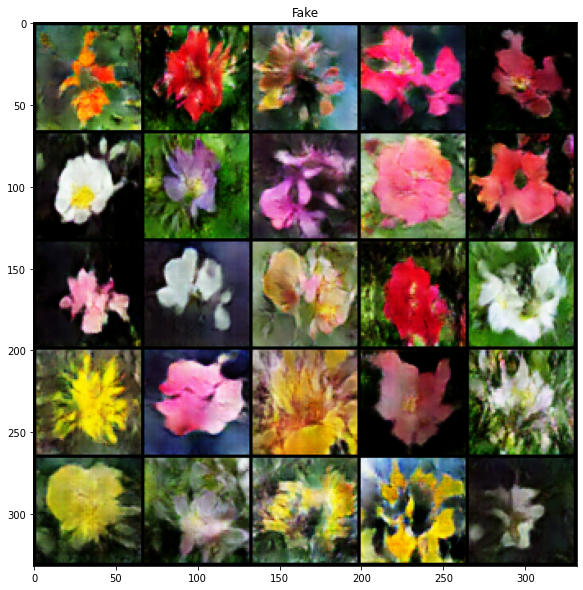

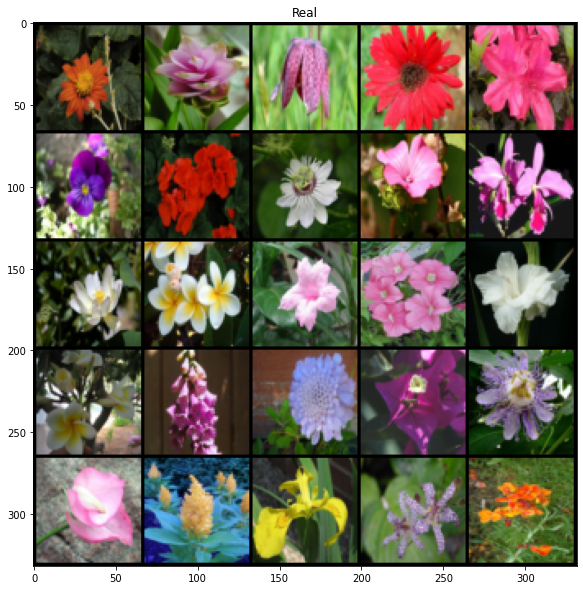

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 142
Generator Loss: 3.1088486964404574
Discr Loss: 0.21445024250447745


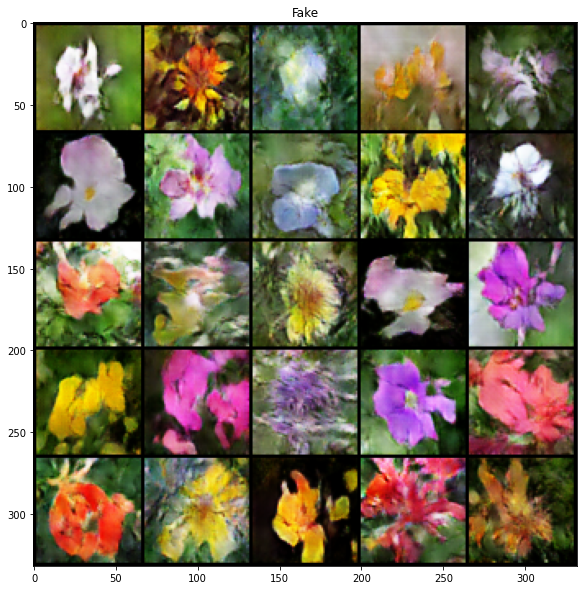

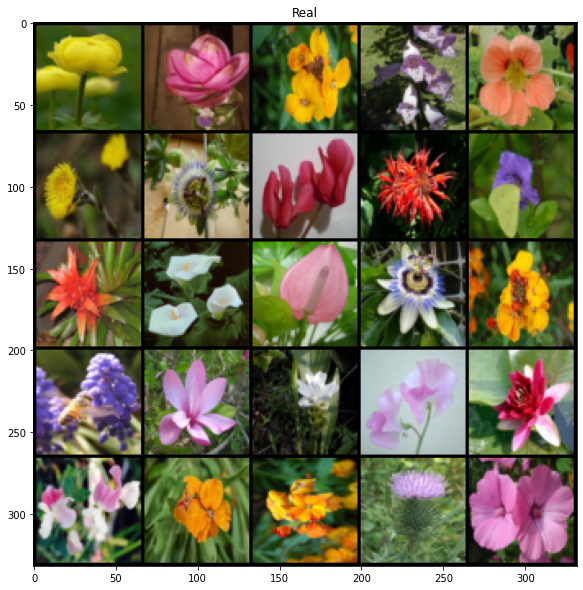

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 153
Generator Loss: 3.2450924928020726
Discr Loss: 0.18250009517371651


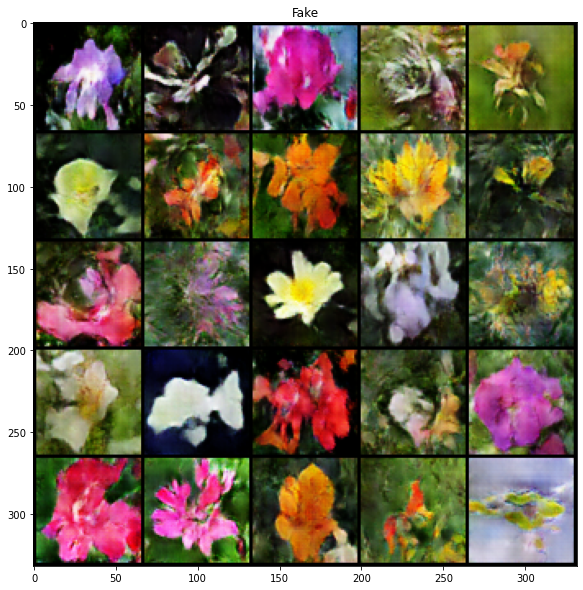

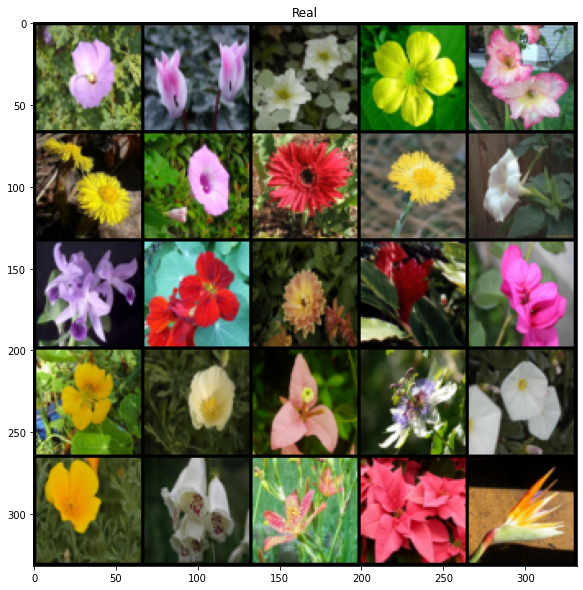

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 163
Generator Loss: 3.1138798589855434
Discr Loss: 0.203232086509466


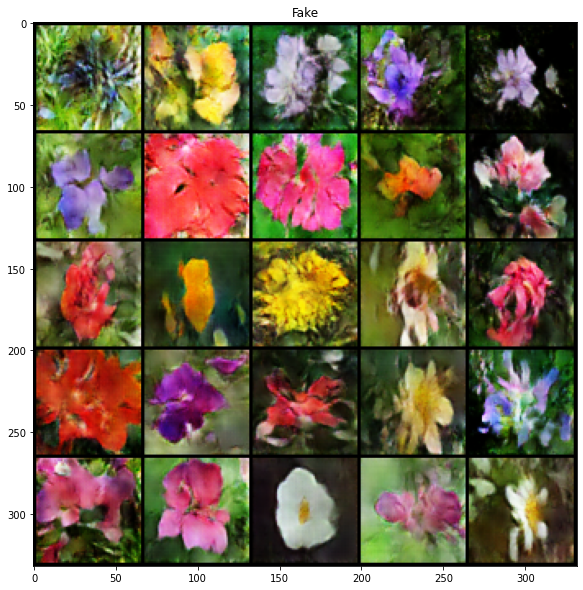

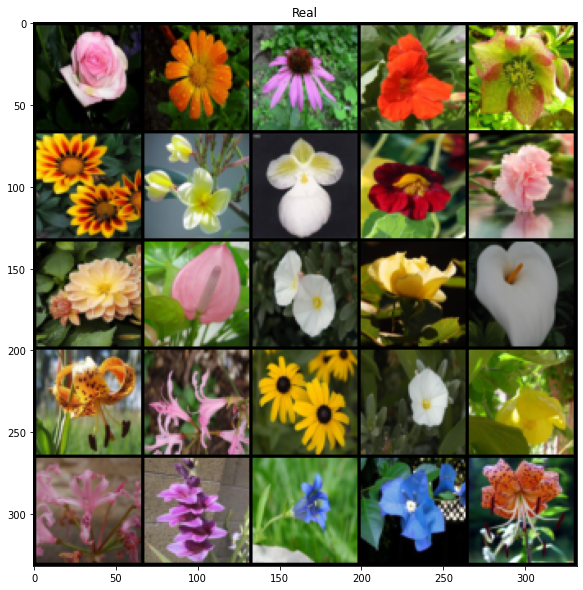

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 173
Generator Loss: 3.2182607843875863
Discr Loss: 0.18283619111031285


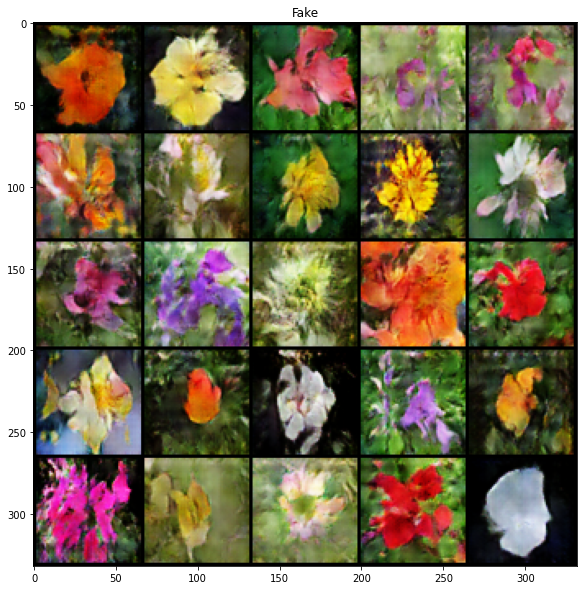

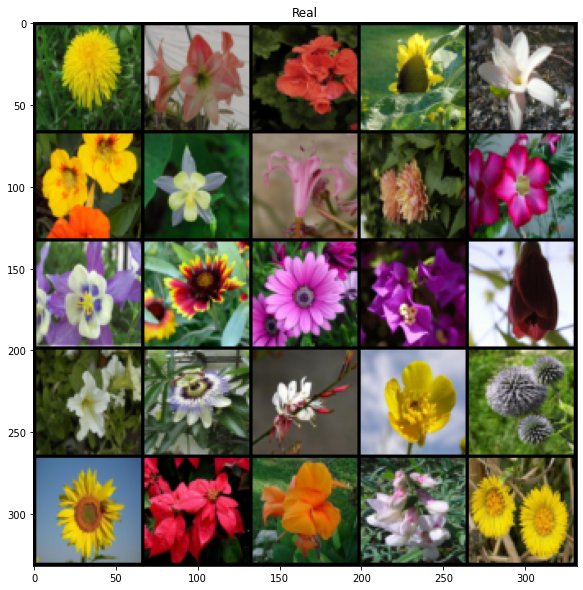

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 183
Generator Loss: 3.2880396066904076
Discr Loss: 0.1557977405637503


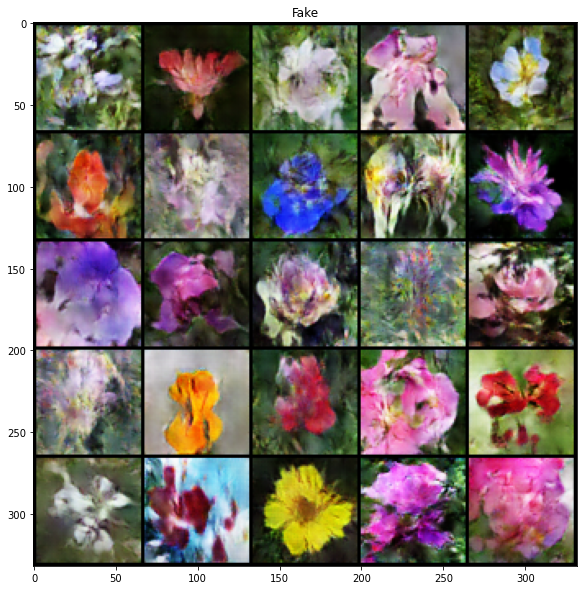

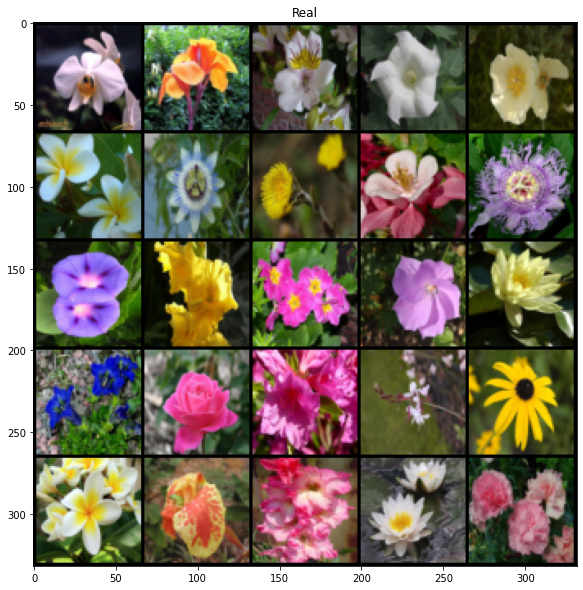

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

Epoch 193
Generator Loss: 3.4172479560524245
Discr Loss: 0.1435795963928103


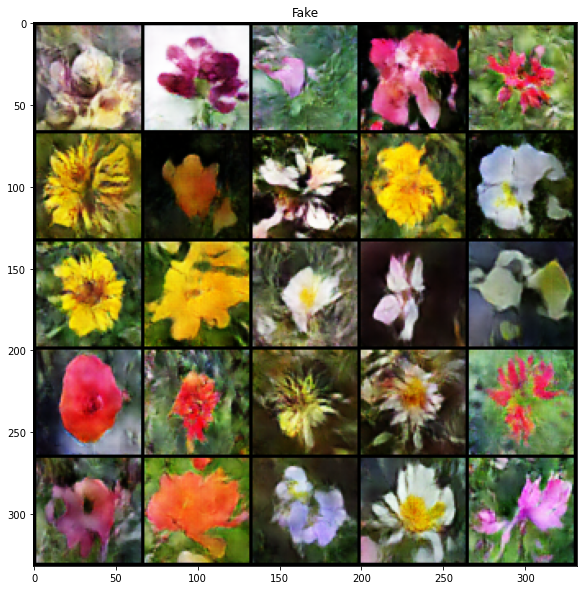

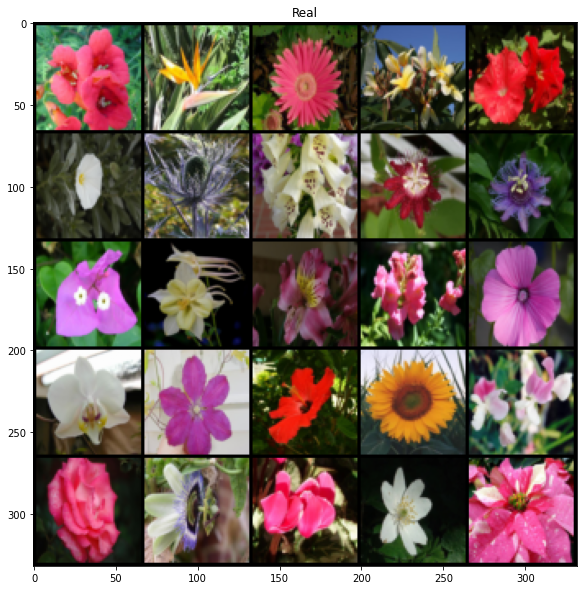

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/49 [00:00<?, ?it/s]

In [14]:
gen_losses = 0
disc_losses = 0
lst_gen_losses = []
lst_disc_losses = []
cur_iter = 0

for epoch in range(epochs):
  for image, _ in tqdm(data_loader):
    cur_batch_size = len(image)
    image = image.to(device)

    # Discriminator Update
    disc_optim.zero_grad()
    output = discriminator(image)
    real_loss_D = criterion(output, torch.ones_like(output))
    real_loss_D.backward()

    fake_noise = get_noise_vectors(cur_batch_size, noise_dim, device=device)
    fake = generator(fake_noise)
    output = discriminator(fake.detach())
    fake_loss_D = criterion(output, torch.zeros_like(output))
    disc_loss = (real_loss_D + fake_loss_D) / 2
    disc_losses += disc_loss.item() / step
    lst_disc_losses += [disc_losses]
    fake_loss_D.backward()
    disc_optim.step()

    # Generator Update
    gen_optim.zero_grad()
    output = discriminator(fake)
    loss_G = criterion(output, torch.ones_like(output))
    loss_G.backward()
    gen_optim.step()
    gen_losses += loss_G.item() / step
    lst_gen_losses += [gen_losses]

    # Progress and Visualization
    if cur_iter % step == 0 and cur_iter > 0:
      print("Epoch {}\nGenerator Loss: {}\nDiscr Loss: {}".format(epoch, gen_losses, disc_losses))
      fake = generator(fake_noise)
      show(fake, 25, 5, title='Fake')
      show(image, 25, 5, title='Real')
      disc_losses = 0
      gen_losses = 0
    cur_iter += 1

In [16]:
torch.save(generator.state_dict(), 'gen_weights.pth')
torch.save(discriminator.state_dict(), 'disc_weights.pth')

In [17]:
generator.eval()

Generator(
  (generator): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(64, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inpla

## **Generating Flowers**

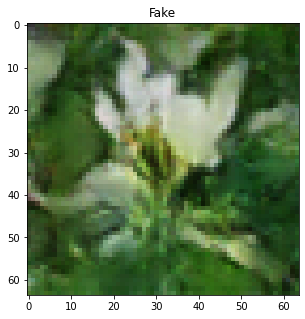

In [70]:
new_noise = get_noise_vectors(1, 64, device=device)
generated = generator(new_noise)
show(generated, 1, 1, 'Fake', 5)